<a href="https://colab.research.google.com/github/Vizzuality/copernicus-climate-data/blob/master/prepare_hourly_pet_climatology.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Prepare data for the copernicus-climate project

https://github.com/Vizzuality/copernicus-climate-data

`Edward P. Morris (vizzuality.)`

## Description
This notebook creates hourly historical histogram summaries for `pet`. All data is written to GCS as Zarr groups for further processing.  

## TODO
+ check dtypes and convert to simpler types; float64 to float32 reduces array size by 2. see https://xarray.pydata.org/en/stable/io.html#writing-encoded-data
+ Transpose so order is min to max variation

```
MIT License

Copyright (c) 2020 Vizzuality

Permission is hereby granted, free of charge, to any person obtaining a copy
of this software and associated documentation files (the "Software"), to deal
in the Software without restriction, including without limitation the rights
to use, copy, modify, merge, publish, distribute, sublicense, and/or sell
copies of the Software, and to permit persons to whom the Software is
furnished to do so, subject to the following conditions:

The above copyright notice and this permission notice shall be included in all
copies or substantial portions of the Software.

THE SOFTWARE IS PROVIDED "AS IS", WITHOUT WARRANTY OF ANY KIND, EXPRESS OR
IMPLIED, INCLUDING BUT NOT LIMITED TO THE WARRANTIES OF MERCHANTABILITY,
FITNESS FOR A PARTICULAR PURPOSE AND NONINFRINGEMENT. IN NO EVENT SHALL THE
AUTHORS OR COPYRIGHT HOLDERS BE LIABLE FOR ANY CLAIM, DAMAGES OR OTHER
LIABILITY, WHETHER IN AN ACTION OF CONTRACT, TORT OR OTHERWISE, ARISING FROM,
OUT OF OR IN CONNECTION WITH THE SOFTWARE OR THE USE OR OTHER DEALINGS IN THE
SOFTWARE.
```

# Setup

Instructions for setting up the computing environment.

In [0]:
%%bash
# Remove sample_data
rm -r sample_data

## Linux dependencies

Instructions for adding linux (including node, ect.) system packages.

``` 
!apt install -q -y <package-name>
!npm install -g <package-name>
```

In [0]:
# Packages for projections and geospatial processing
!apt install -q -y libspatialindex-dev libproj-dev proj-data proj-bin libgeos-dev graphviz

Reading package lists...
Building dependency tree...
Reading state information...
graphviz is already the newest version (2.40.1-2).
proj-data is already the newest version (4.9.3-2).
proj-data set to manually installed.
Suggested packages:
  libgdal-doc
The following NEW packages will be installed:
  libgeos-dev libproj-dev libspatialindex-c4v5 libspatialindex-dev
  libspatialindex4v5 proj-bin
0 upgraded, 6 newly installed, 0 to remove and 31 not upgraded.
Need to get 860 kB of archives.
After this operation, 5,014 kB of additional disk space will be used.
Get:1 http://archive.ubuntu.com/ubuntu bionic/universe amd64 libgeos-dev amd64 3.6.2-1build2 [73.1 kB]
Get:2 http://archive.ubuntu.com/ubuntu bionic/universe amd64 libspatialindex4v5 amd64 1.8.5-5 [219 kB]
Get:3 http://archive.ubuntu.com/ubuntu bionic/universe amd64 libspatialindex-c4v5 amd64 1.8.5-5 [51.7 kB]
Get:4 http://archive.ubuntu.com/ubuntu bionic/universe amd64 libproj-dev amd64 4.9.3-2 [199 kB]
Get:5 http://archive.ubuntu.

## Python packages

Consider using package versions to ensure nothing changes.

`!pip install -q <package-name>`

In [0]:
# connect to Google cloud storage
!pip install -q gcsfs 

In [0]:
# geospatial tools
!pip install -q country-converter rtree geopandas shapely fiona

     |████████████████████████████████| 51kB 1.7MB/s 
     |████████████████████████████████| 71kB 4.1MB/s 
     |████████████████████████████████| 931kB 39.6MB/s 
     |████████████████████████████████| 14.7MB 303kB/s 
     |████████████████████████████████| 10.9MB 53.9MB/s 


In [0]:
# netcdf, xarray, xclim, and Zarr tools
!pip install -q cftime netcdf4 nc-time-axis zarr xarray xclim rioxarray regionmask sparse bottleneck

     |████████████████████████████████| 327kB 2.8MB/s 
     |████████████████████████████████| 4.1MB 12.0MB/s 
     |████████████████████████████████| 3.3MB 28.8MB/s 
     |████████████████████████████████| 143kB 49.1MB/s 
     |████████████████████████████████| 3.7MB 62.5MB/s 
     |████████████████████████████████| 122kB 60.0MB/s 
     |████████████████████████████████| 71kB 8.7MB/s 
     |████████████████████████████████| 3.8MB 51.9MB/s 
     |████████████████████████████████| 174kB 57.9MB/s 
     |████████████████████████████████| 194kB 63.8MB/s 
     |████████████████████████████████| 18.2MB 241kB/s 
     |████████████████████████████████| 14.4MB 216kB/s 
     |████████████████████████████████| 634kB 54.2MB/s 
     |████████████████████████████████| 225kB 54.2MB/s 
     |████████████████████████████████| 102kB 13.1MB/s 
ERROR: distributed 2.16.0 has requirement tornado>=5; python_version < "3.8", but you'll have tornado 4.5.3 which is incompatible.
ERROR: sparse 0.10.0 has require

In [0]:
!pip install graphviz

In [0]:
# Show python package versions
!pip list

Package                  Version        
------------------------ ---------------
absl-py                  0.9.0          
affine                   2.3.0          
alabaster                0.7.12         
albumentations           0.1.12         
altair                   4.1.0          
asciitree                0.3.3          
asgiref                  3.2.7          
astor                    0.8.1          
astropy                  4.0.1.post1    
astunparse               1.6.3          
atari-py                 0.2.6          
atomicwrites             1.4.0          
attrs                    19.3.0         
audioread                2.1.8          
autograd                 1.3            
Babel                    2.8.0          
backcall                 0.1.0          
beautifulsoup4           4.6.3          
bleach                   3.1.5          
blis                     0.4.1          
bokeh                    1.4.0          
boltons                  20.1.0         
boto            

## Authorisation

Setting up connections and authorisation to cloud services.

### Google Cloud

This can be done in the URL or via adding service account credentials.

If you do not share the notebook, you can mount your Drive and and transfer credentials to disk. Note if the notebook is shared you always need to authenticate via URL.  

In [0]:
# Set Google Cloud information
gc_project = "skydipper-196010"
gc_creds = "skydipper-196010-f842645fd0f3.json"
gc_user = "edward-morris@skydipper-196010.iam.gserviceaccount.com"
gcs_prefix = "gs://copernicus-climate"

In [0]:
# For auth WITHOUT service account
# https://cloud.google.com/resource-manager/docs/creating-managing-projects
#from google.colab import auth
#auth.authenticate_user()
#!gcloud config set project {project_id}

In [0]:
# If the notebook is shared
#from google.colab import drive
#drive.mount('/content/drive')

In [0]:
# If Drive is mounted, copy GC credentials to home (place in your GDrive, and connect Drive)
!cp "/content/drive/My Drive/{gc_creds}" "/root/.{gc_creds}"

In [0]:
# Auth WITH service account
!gcloud auth activate-service-account {gc_user} --key-file=/root/.{gc_creds} --project={gc_project}


Activated service account credentials for: [edward-morris@skydipper-196010.iam.gserviceaccount.com]


In [0]:
# Test GC auth
!gsutil ls {gcs_prefix}

gs://copernicus-climate/heatwaves_historical_Basque.zip
gs://copernicus-climate/heatwaves_longterm_Basque.zip
gs://copernicus-climate/spain.zarr.zip
gs://copernicus-climate/coldsnaps/
gs://copernicus-climate/data_for_PET/
gs://copernicus-climate/dataset/
gs://copernicus-climate/european-nuts-lau-geometries.zarr/
gs://copernicus-climate/heatwaves/
gs://copernicus-climate/pet/
gs://copernicus-climate/spain-zonal-stats.zarr/
gs://copernicus-climate/spain.zarr/
gs://copernicus-climate/tasmax/
gs://copernicus-climate/tasmin/
gs://copernicus-climate/to_delete/
gs://copernicus-climate/zonal_stats/


# Utils

Generic helper functions used in the subsequent processing. For easy navigation each function seperated into a section with the function name.

## copy_gcs

In [0]:
import os
import subprocess

def copy_gcs(source_list, dest_list, opts=""):
  """
  Use gsutil to copy each corresponding item in source_list
  to dest_list.

  Example:
  copy_gcs(["gs://my-bucket/data-file.csv"], ["."])

  """
  for s, d  in zip(source_list, dest_list):
    cmd = f"gsutil -m cp -r {opts} {s} {d}"
    print(f"Processing: {cmd}")
    r = subprocess.call(cmd, shell=True)
    if r == 0:
        print("Task created")
    else:
        print("Task failed")
  print("Finished copy")

## mkdirs

In [0]:
from pathlib import Path

def mkdirs(dirs_list, exist_ok=True):
  """ Create nested directories
  """
  for p in dirs_list:
    Path(p).mkdir(parents=True, exist_ok=exist_ok)


## set_acl_to_public

In [0]:
import subprocess

# Set to asset permissions to public for https read
def set_acl_to_public(gs_path):
  """ 
  Set all Google Storage assets to puplic read access.

  Requires GS authentication

  Parameters
  ----------
  gs_path str
    The google storage path, note the "-r" option is used, setting the acl of all assets below this path
  """
  cmd = f"gsutil -m acl -r ch -u AllUsers:R {gs_path}"
  print(cmd)
  r = subprocess.call(cmd, shell=True)
  if r is 0:
    print("Set acl(s) sucsessful")
  else:
    print("Set acl(s) failed")  

#set_acl_to_public("gs://skydipper-water-quality/cloud-masks")

In [0]:
%%time
#rmv_remote_zarr_group('pet-minmax-monthly-era5', root = "copernicus-climate/spain.zarr")

CPU times: user 3 µs, sys: 0 ns, total: 3 µs
Wall time: 6.2 µs


## get_size_remote_zarr

In [0]:
import os
import subprocess

def get_size_remote_zarr(
    group,
    root):
  
  # Get size using gsutil
  if group:
    p = f"gs://{root}/{group}"
  else:
    p = f"gs://{root}"  
  cmd = f"gsutil -m du -sh {p}"
  print(f"Processing: {cmd}")
  r = subprocess.getoutput(cmd)
  print(r)

## get_cached_remote_zarr

In [0]:
import gcsfs
import zarr
import xarray as xr



def get_cached_remote_zarr(
    group,
    root,
    project_id = gc_project,
    token=f"/root/.{gc_creds}",
    force_consolidate=False):
  
  # Connect to GS
  gc = gcsfs.GCSFileSystem(project=project_id, token=token)
  store = gc.get_mapper(root, check=False, create=True)
  if force_consolidate:
    # consolidate metadata at root
    zarr.consolidate_metadata(store)
  # Check zarr is consolidated
  consolidated = gc.exists(f'{root}/.zmetadata')
  # Cache the zarr store
  #store = zarr.ZipStore(store, mode='r')
  cache = zarr.LRUStoreCache(store, max_size=4737418240)
  # Return cached zarr group
  return xr.open_zarr(cache, group=group, consolidated=consolidated)

## write_to_remote_zarr

In [0]:
import gcsfs
import zarr
import xarray as xr

def write_to_remote_zarr(
    ds,
    group,
    root,
    mode = 'w',
    append_dim = None,    
    encoding = None,
    unchunk_coords = True,
    project_id = gc_project,
    token=f"/root/.{gc_creds}",
    show_tree = True,
    compute = True
    ):
  print("Starting to write to Zarr...\n")
  # Connect to GS
  gc = gcsfs.GCSFileSystem(project=project_id, token=token)
  store = gc.get_mapper(root, check=False, create=True)
  print("GCS store is setup\n")
  # consolidate metadata at root
  #zarr.consolidate_metadata(store)
  #print("Consolidated metadata\n")
  # Write to zarr group
  print("Writing to store...\n")
  if append_dim is not None:
    mode = 'a'
  with ProgressBar():
    if compute is False:  
      task = ds.to_zarr(store=store, group=group, mode=mode, consolidated=True, encoding=encoding, append_dim = append_dim, compute=compute)
    else:  
      ds.to_zarr(store=store, group=group, mode=mode, consolidated=True, encoding=encoding, append_dim = append_dim, compute=compute)
  print("\n...done\n")
  # consolidate metadata at root
  zarr.consolidate_metadata(store)
  #print("Consolidated metadata\n")
  c = gc.exists(f"{root}/.zmetadata")
  print(f"{root} is consoldiated? {c}\n")
  # unchunk coordinates
  # TODO: optimise this for remote ZARR
  #if unchunk_coords:
  #  unchunk_dataset(store, coords_only = True)
  if show_tree:
    with zarr.open_consolidated(store, mode='r') as z:
      print(z.tree())
  if compute is False:
    return task



## rmv_remote_zarr

In [0]:
import gcsfs
import zarr

def rmv_remote_zarr(
    group,
    root,
    project_id = gc_project,
    token=f"/root/.{gc_creds}",
     show_tree=False):
  
  # Connect to GS
  gc = gcsfs.GCSFileSystem(project=project_id, token=token)
  store = gc.get_mapper(root, check=False, create=True)
  # Remove zarr group
  print(f"Removing {root}/{group}")
  zarr.storage.rmdir(store, path=group)
  # consolidate metadata at root
  zarr.consolidate_metadata(store)
  if show_tree:
    with zarr.open_consolidated(store, mode='r') as z:
      print(z.tree())

## interpolate_dataset

In [0]:
import numpy as np

def interpolate_dataset(ds, dx, dy):
  # get bounds
  lon = ds.lon.values
  lat = ds.lat.values
  lonmin = lon.min()
  latmin = lat.min()
  lonmax = lon.max()
  latmax = lat.max()
  # create new lat and lon
  new_lon = np.arange(lonmin, lonmax, step=dx)
  #new_lon = np.linspace(lonmin, lonmax, num=ds.dims['lon'] * factor)
  #print(new_lon)
  new_lat = np.arange(latmin, latmax, step=dy)
  #new_lat = np.linspace(latmin, latmax, num=ds.dims['lat'] * factor)
  #print(new_lat)
  # convert na values
  #filled = ds.fillna(-9999)
  # interpolate
  out = ds.interp(lat=new_lat, lon=new_lon, method='linear')
  # fill na gaps
  #out = out.interpolate_na('lon').interpolate_na('lat')
  # return masked array
  return out#.where(ds.notnull)

## add_area

In [0]:
import numpy as np
import numpy.matlib
import xarray as xr
import rioxarray

def add_area(ds):
  """
  Add DataArrays of the area in km2 and area weight of each array cell

  """
  # get info
  lon = ds.lon.values
  lat = ds.lat.values
  xdim = len(lon)
  ydim = len(lat)
  lonmin = lon.min()
  latmin = lat.min()
  lonmax = lon.max()
  latmax = lat.max()
  xres = (lonmax - lonmin) / xdim
  yres = (latmax - latmin) / ydim 
  
  # create lats + yres
  lats = np.linspace(int(latmin), int(latmax) + yres, ydim + 1)
  
  # constants
  a = 6378137
  b = 6356752.3142

  # Degrees to radians
  lats = lats * np.pi/180

  # Intermediate vars
  e = np.sqrt(1-(b/a)**2)
  sinlats = np.sin(lats)
  zm = 1 - e * sinlats
  zp = 1 + e * sinlats

  # Distance between meridians
  q = yres/360
  # q = pix_width/360

  # Compute areas for each latitude in square km
  areas_to_equator = np.pi * b**2 * ((2*np.arctanh(e*sinlats) / (2*e) + sinlats / (zp*zm))) / 10**6
  areas_between_lats = np.diff(areas_to_equator)
  areas_cells = np.abs(areas_between_lats) * q
  areagrid = np.transpose(np.matlib.repmat(areas_cells, xdim, 1))
  
  # Sum total area
  #tot_area = np.sum(areagrid)

  # Add area in km2
  da = xr.DataArray(
      data=areagrid,
      name='area_km2',
      coords=[lat, lon],
      dims=['lat', 'lon'], 
      attrs=None, indexes=None, fastpath=False)
  # Add area_weight
  #ds['area_weight'] = ds['area_km2'] / tot_area
  
  return ds.assign({'area_km2': da.chunk({'lat':-1, 'lon':-1})})



## set_lat_lon_attrs

In [0]:
def set_lat_lon_attrs(ds):
  """ Set CF latitude and longitude attributes"""
  ds["lon"] = ds.lon.assign_attrs({
    'axis' : 'X',
     'long_name' : 'longitude',
      'standard_name' : 'longitude',
       'stored_direction' : 'increasing',
        'type' : 'double',
         'units' : 'degrees_east',
          'valid_max' : 360.0,
           'valid_min' : -180.0
           })
  ds["lat"] = ds.lat.assign_attrs({
    'axis' : 'Y',
     'long_name' : 'latitude',
      'standard_name' : 'latitude',
       'stored_direction' : 'increasing',
        'type' : 'double',
         'units' : 'degrees_north',
          'valid_max' : 90.0,
           'valid_min' : -90.0
           })
  return ds
  

## create_ds_mask

In [0]:
import regionmask
import xarray as xr
import rioxarray
import geopandas
import numpy as np

def create_ds_mask(df, ds, id_prop, name_prop, name):
  
  # Get mean ds cell area (in degrees) 
  mean_y_size = np.diff(ds.lat.values).mean()
  #print(mean_y_size)
  mean_x_size = np.diff(ds.lat.values).mean()
  #print(mean_x_size)
  mean_area = mean_y_size * mean_x_size
  print(f"The mean ds cell area is {np.round(mean_area, 6)} deg.\n")
  
  # Clip gdf to bounding box of ds
  xmin = ds.lon.min().values.tolist()
  xmax = ds.lon.max().values.tolist()
  ymin = ds.lat.min().values.tolist()
  ymax = ds.lat.max().values.tolist()
  df = df.cx[xmin:xmax, ymin:ymax]
  
  
  # Add area of geoms to gdf
  df = df.assign(area = df.area)
  df = df.assign(area_is_gt_cell = df['area'] > mean_area)
  print(f"Clipped gdf to dataset bounds, giving {len(df[id_prop])} potential geometries, of which {df['area_is_gt_cell'].sum()} are large enough.\n")
  
  print("Geometries smaller than mean cell size:")
  print(df.loc[df['area_is_gt_cell'] == False, [id_prop, name_prop]])
  print("\n")

  # Extract geoms, codes, names, and create code_ints that are large enough!
  id_names = df.loc[df['area_is_gt_cell'] == True, name_prop].values
  #print(id_names)
  id_codes = df.loc[df['area_is_gt_cell'] == True, id_prop].values
  #print(id_codes)
  geoms = df.loc[df['area_is_gt_cell'] == True, 'geometry'].values
  id_ints = list(range(0, len(id_codes)))
  #print(id_ints)

  # create mask object
  m = regionmask.Regions(
    name = name,
    numbers = id_ints,
    names = id_names,
    abbrevs = id_codes,
    outlines = geoms)\
    .mask(ds)\
    .rename(name)
  
  # get the ints written to mask
  d = dict(zip(id_ints, id_names))
  #print(d)
  d2 = dict(zip(id_ints, id_codes))
  #print(d2)
  id_ints2 = m.to_dataframe().dropna()[name].unique() 
  #print(id_ints2)
  id_names2 = [d[k] for k in [int(i) for i in id_ints2]]
  id_codes2 = [d2[k] for k in [int(i) for i in id_ints2]]
  
  print(f"Finished writing {len(id_codes2)} geometries to {name} mask.\n")
  
  # update da attributes
  m.attrs['id_ints'] = id_ints2
  m.attrs['id_codes'] = id_codes2  
  m.attrs['id_names'] = id_names2
  m = set_lat_lon_attrs(m)
  return m
  

## area_wt_mean

In [0]:
import shapely
import pandas as pd
from dask.diagnostics import ProgressBar, Profiler, ResourceProfiler, CacheProfiler, visualize
import matplotlib.pyplot as plt

def area_wt_mean2(ds, dvars, id_prop, mask_name, debug=False):
  
  # Calculations
  print("\nCalculating area-weighted mean per group...\n")
  with ProgressBar():
      # Collect items for calcs
      print("\n- collect items for calcs\n")
      ids = ds[mask_name].attrs['id_ints'].astype('int')
      codes = ds[mask_name].attrs['id_codes']
      names = ds[mask_name].attrs['id_names']
      code_dict = dict(zip(ids, codes))
      name_dict = dict(zip(ids, names))
      mask = ds[mask_name]
      weights = ds.area_km2
      weights_na = weights.where(mask.notnull())
      weighted_ds = ds[dvars] * weights
      if debug:
        print("\n--mask.\n")
        print(mask)
        print("\n--weights_na.\n")
        print(weights_na)
        print("\n--weighted ds.\n")
        print(weighted_ds)
        fig, axs = plt.subplots(3,1, figsize=(5,10), constrained_layout=True, squeeze=True)
        axs = axs.flat; N = 4; [ax.remove() for ax in axs[N:]]; axs = axs[:N]
        mask.plot(ax=axs[0])
        weights.plot(ax=axs[1])
        weights_na.plot(ax=axs[2])
        fig.suptitle("Mask and weights", fontsize=16)
        plt.show()

      # Loop through ids
      #print("\n- loop through mask ids...\n")
      #mean_das =  [weighted_ds.where(mask == i, drop=False).sum(skipna=True) / weights_na.where(mask == i, drop=False).sum(skipna=True) for i in ids]
      #print("\n...done\n")
      # Concat
      #print("\n- concat ds\n")
      #out = xr.concat(mean_das, dim=mask_name)
      
      print("\n- groupby mask ids...\n")
      out = ( weighted_ds.groupby(mask).sum(skipna=True) / weights_na.groupby(mask).sum(skipna=True) )
      print("\n...done\n")
      # Adjust dtype (as always becomes float64?)
      out = out.astype('float32')
      # Adjust names
      out = out.rename({mask_name:id_prop})
      out = out.rename( dict(zip(dvars, [f"{v}_mean" for v in dvars])))
      # Rename id_prop using lookup
      wm_ids = out[id_prop].astype('int').values.tolist()
      wm_codes = [code_dict[i] for i in wm_ids] 
      wm_names = [name_dict[i] for i in wm_ids]
      out[id_prop] = wm_codes
      
      if debug:
        print("\n- area-weighted mean CODES:\n")
        print(len(wm_codes))
        print(wm_codes)
        print("\n- area-weighted mean NAMES:\n")
        print(len(wm_names))
        print(wm_names)
        print("\n- area-weighted mean chunks:\n")
        print(out.chunks)
        print("\n- area-weighted mean size in GB\n")
        print(out.nbytes / 1073741824)
        print("\n...weighted_mean ds:\n")
        print(out)
  print("\n...done")
  # Rechunk
  out = out.chunk({id_prop:-1})
  return out

In [0]:
import shapely
import pandas as pd
from dask.diagnostics import ProgressBar

def area_wt_mean(ds, dvars, id_prop, mask_name, debug=False):
  # Rechunk to avoid very large calculations?
  
  # Get stuff
  mask = ds[mask_name]
  weights = ds.area_km2
  weights_na = weights.where(ds[dvars].mean().notnull())
  weighted_da = ds[dvars] * weights

  # Calculations
  print("\nCalc weighted sums per group...\n")
  with ProgressBar():
    w_sum = weighted_da.groupby(mask).sum(skipna=True)
    sum_w = weights_na.groupby(mask).sum(skipna=True)
  print("\n...done")

  # Include area for diagnostics?
  #.rename("total_area")
  
  # weighted mean
  print("\nCalc weighted mean per group...\n")
  with ProgressBar():
    out = ( w_sum / sum_w )
  if debug:
    print("\nweighted_mean ds:\n")
    print(out)
  out = out.rename( dict(zip(dvars, [f"{v}_mean" for v in dvars])))
  print("\n...done\n")

  # add id index
  out = out.rename({mask_name:id_prop})
  out = out.astype('float32')
  
  # create key-pair dict
  ids = ds[mask_name].attrs['id_ints'].astype('int')#.tolist()
  codes = ds[mask_name].attrs['id_codes']#.tolist()
  names = ds[mask_name].attrs['id_names']#.tolist()
  code_dict = dict(zip(ids, codes))
  name_dict = dict(zip(ids, names))

  # get the ints actually written to mask
  wm_ids = out[id_prop].astype('int').values.tolist()

  # convert to codes
  wm_codes = [code_dict[i] for i in wm_ids] 
  wm_names = [name_dict[i] for i in wm_ids]
  if debug:
    print("\nArea-weighted mean CODES\n")
    print(len(wm_codes))
    print(wm_codes)
    print("\nArea-weighted mean NAMES\n")
    print(len(wm_names))
    print(wm_names)
    print("\Area-weighted mean chunks\n")
    print(out.chunks)
    print("\Area-weighted mean size in GB\n")
    print(out.nbytes / 1073741824)
  out[id_prop] = wm_codes
  #out.coords['geonames'] = wm_names
  return out.chunk({id_prop:-1})

# Processing

Data processing organised into sections.

## Get historical hourly PET

In [0]:
# Creat directory structure
ds_dir = "dataset"
mkdirs([ds_dir])

In [0]:
#%%time
# Here we are only reading the metadata!
ds_pet = get_cached_remote_zarr("pet-hourly-era5", 'copernicus-climate/spain.zarr')
ds_pet

,Array,Chunk
Bytes,31.69 GB,11.70 MB
Shape,"(3, 3, 3, 130008, 37, 61)","(3, 3, 3, 48, 37, 61)"
Count,2710 Tasks,2709 Chunks
Type,float32,numpy.ndarray


## Zonal hourly histograms per month

In [0]:
# Select met 80, clothing 0.9, female adult
ds_pets = ds_pet.sel(met=80.0, clo=0.9, gender='female', age_cat='adult', drop=True)
ds_pets = ds_pets.chunk({'time':24*30})
print(ds_pets)
# Create month-hour multi index
ds_peth = ds_pets.assign_coords(month=ds_pets.time.dt.month, hour=ds_pets.time.dt.hour)
ds_peth = ds_peth.set_index(time=['month', 'hour'])
ds_peth = ds_peth.stack(space=['lon', 'lat'])
ds_peth

<xarray.Dataset>
Dimensions:  (lat: 37, lon: 61, time: 130008)
Coordinates:
  * lat      (lat) float64 44.0 43.75 43.5 43.25 43.0 ... 35.75 35.5 35.25 35.0
  * lon      (lon) float64 -10.0 -9.75 -9.5 -9.25 -9.0 ... 4.0 4.25 4.5 4.75 5.0
  * time     (time) datetime64[ns] 2005-01-01 ... 2019-10-31T23:00:00
Data variables:
    pet      (time, lat, lon) float32 dask.array<chunksize=(720, 37, 61), meta=np.ndarray>
Attributes:
    description:  Physiologically Equivalent Temperature (PET) calculated for...
    history:      
    source:       ERA5 available from the Copernicus Climate Data Service


,Array,Chunk
Bytes,1.17 GB,6.50 MB
Shape,"(130008, 2257)","(720, 2257)"
Count,5962 Tasks,181 Chunks
Type,float32,numpy.ndarray


In [0]:
%%time
# From https://stackoverflow.com/questions/59311359/how-to-make-a-memory-efficient-multiple-dimension-groupby-stack-using-xarray
def time_series_stack(time_da, time_dim='time', grp1='hour', grp2='month'):
    """Takes a time-series xr.DataArray objects and reshapes it using
    grp1 and grp2. output is a xr.Dataset that includes the reshaped DataArray
    , its datetime-series and the grps. plots the mean also"""
    import xarray as xr
    import pandas as pd
    # try to infer the freq and put it into attrs for later reconstruction:
    freq = pd.infer_freq(time_da[time_dim].values)
    name = time_da.name
    time_da.attrs['freq'] = freq
    attrs = time_da.attrs
    # drop all NaNs:
    time_da = time_da.dropna(time_dim)
    # first grouping:
    grp_obj1 = time_da.groupby(time_dim + '.' + grp1)
    da_list = []
    t_list = []
    for grp1_name, grp1_inds in grp_obj1.groups.items():
        da = time_da.isel({time_dim: grp1_inds})
        # second grouping:
        grp_obj2 = da.groupby(time_dim + '.' + grp2)
        for grp2_name, grp2_inds in grp_obj2.groups.items():
            da2 = da.isel({time_dim: grp2_inds})
            # extract datetimes and rewrite time coord to 'rest':
            times = da2[time_dim]
            times = times.rename({time_dim: 'rest'})
            times.coords['rest'] = range(len(times))
            t_list.append(times)
            da2 = da2.rename({time_dim: 'rest'})
            da2.coords['rest'] = range(len(da2))
            da_list.append(da2)
    # get group keys:
    grps1 = [x for x in grp_obj1.groups.keys()]
    grps2 = [x for x in grp_obj2.groups.keys()]
    # concat and convert to dataset:
    stacked_ds = xr.concat(da_list, dim='all').to_dataset(name=name)
    stacked_ds[time_dim] = xr.concat(t_list, 'all')
    # create a multiindex for the groups:
    mindex = pd.MultiIndex.from_product([grps1, grps2], names=[grp1, grp2])
    stacked_ds.coords['all'] = mindex
    # unstack:
    ds = stacked_ds.unstack('all')
    ds.attrs = attrs
    return ds

tst = time_series_stack(ds_pets.pet, time_dim='time', grp1='hour', grp2='month')
tst    

CPU times: user 56.9 s, sys: 11.4 s, total: 1min 8s
Wall time: 6min 10s


In [0]:
tst

,Array,Chunk
Bytes,1.21 GB,2.71 MB
Shape,"(465, 37, 61, 24, 12)","(25, 37, 61, 1, 12)"
Count,247814 Tasks,4248 Chunks
Type,float32,numpy.ndarray


### Mean

In [0]:
%%time
# Select a single cell, and month
#sel = tst.pet.isel(lat= 10, lon=10).sel(month=8)

CPU times: user 2 µs, sys: 0 ns, total: 2 µs
Wall time: 5.01 µs


In [0]:
%%time
# Mean hourly climatology for single month
#sel.mean('rest').plot()

CPU times: user 1e+03 ns, sys: 0 ns, total: 1e+03 ns
Wall time: 4.77 µs


### Quantiles

[0.  0.1 0.2 0.3 0.4 0.5 0.6 0.7 0.8 0.9 1. ]
CPU times: user 1min 7s, sys: 9.57 s, total: 1min 16s
Wall time: 48.3 s


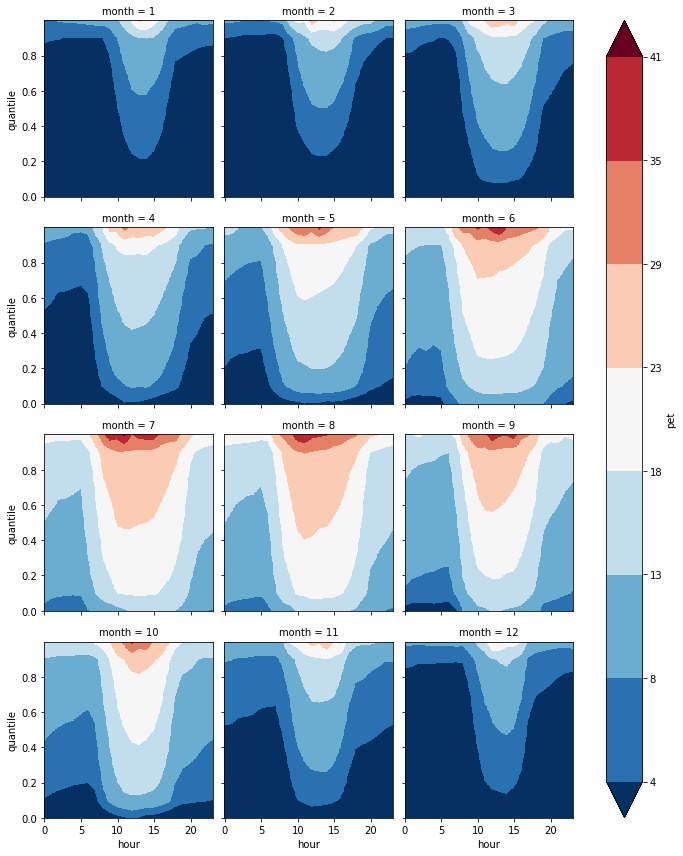

In [0]:
%%time
import numpy as np

lat = 43.2567
lon = -2.9241 
step = 0.0001
stepq = 0.1
quantiles = np.arange(0.0, 1.0 + stepq, stepq)
print(quantiles) 
levels = [4, 8, 13, 18, 23, 29, 35, 41]

# Quantiles of hourly PET climatology per month for a single cell (Bilbao)
q = tst.pet.sel(lat=lat, lon=lon, method='nearest')\
.stack(time= ['month', 'hour'])\
.chunk({'rest':-1})\
.groupby('time')\
.quantile(q=quantiles, dim='rest')\
.interp(quantile = np.arange(0.0, 1.0, step))\
.unstack('time')\
.interp(hour = np.arange(0.0, 23.0 + stepq, stepq))
q.plot(col= 'month', col_wrap=3, levels=levels)

In [0]:
%%time
import numpy as np

lat = 43.2567
lon = -2.9241 
step = 0.0001
stepq = 0.1
quantiles = np.arange(0.0, 1.0 + stepq, stepq)
print(quantiles) 
levels = [4, 8, 13, 18, 23, 29, 35, 41]

# Quantiles of hourly PET climatology per month
q = tst.pet\
.stack(time= ['month', 'hour'])\
.chunk({'rest':-1})\
.groupby('time')\
.quantile(q=quantiles, dim='rest')\
.unstack('time')
print(q)

[0.  0.1 0.2 0.3 0.4 0.5 0.6 0.7 0.8 0.9 1. ]
<xarray.DataArray 'pet' (lat: 37, lon: 61, quantile: 11, month: 12, hour: 24)>
dask.array<reshape, shape=(37, 61, 11, 12, 24), dtype=float64, chunksize=(37, 61, 11, 1, 24), chunktype=numpy.ndarray>
Coordinates:
  * lat       (lat) float64 44.0 43.75 43.5 43.25 43.0 ... 35.75 35.5 35.25 35.0
  * lon       (lon) float64 -10.0 -9.75 -9.5 -9.25 -9.0 ... 4.25 4.5 4.75 5.0
  * quantile  (quantile) float64 0.0 0.1 0.2 0.3 0.4 0.5 0.6 0.7 0.8 0.9 1.0
  * month     (month) int64 1 2 3 4 5 6 7 8 9 10 11 12
  * hour      (hour) int64 0 1 2 3 4 5 6 7 8 9 ... 14 15 16 17 18 19 20 21 22 23
CPU times: user 1.72 s, sys: 0 ns, total: 1.72 s
Wall time: 1.71 s


In [0]:
q.to_dataset()

<xarray.Dataset>
Dimensions:   (hour: 24, lat: 37, lon: 61, month: 12, quantile: 11)
Coordinates:
  * lat       (lat) float64 44.0 43.75 43.5 43.25 43.0 ... 35.75 35.5 35.25 35.0
  * lon       (lon) float64 -10.0 -9.75 -9.5 -9.25 -9.0 ... 4.25 4.5 4.75 5.0
  * quantile  (quantile) float64 0.0 0.1 0.2 0.3 0.4 0.5 0.6 0.7 0.8 0.9 1.0
  * month     (month) int64 1 2 3 4 5 6 7 8 9 10 11 12
  * hour      (hour) int64 0 1 2 3 4 5 6 7 8 9 ... 14 15 16 17 18 19 20 21 22 23
Data variables:
    pet       (lat, lon, quantile, month, hour) float64 dask.array<chunksize=(37, 61, 11, 1, 24), meta=np.ndarray>

In [0]:
#write_to_remote_zarr(q.to_dataset(), group='hourly-pet-climatology-per-month-2005-2019', root='copernicus-climate/spain.zarr')

Starting to write to Zarr...

GCS store is setup

Writing to store...

Finished writing

copernicus-climate/spain.zarr is consoldiated? True

/
 ├── future-longterm-yr10
 │   ├── coldsnap_alarms (8, 5, 2, 91, 146) float32
 │   ├── coldsnap_alerts (8, 5, 2, 91, 146) float32
 │   ├── coldsnap_warnings (8, 5, 2, 91, 146) float32
 │   ├── experiment (2,) object
 │   ├── heatwave_alarms (8, 5, 2, 91, 146) float32
 │   ├── heatwave_alerts (8, 5, 2, 91, 146) float32
 │   ├── heatwave_warnings (8, 5, 2, 91, 146) float32
 │   ├── lat (91,) float64
 │   ├── lon (146,) float64
 │   ├── model (5,) object
 │   ├── tasmax (8, 5, 2, 91, 146) float32
 │   ├── tasmin (8, 5, 2, 91, 146) float32
 │   └── time (8,) int64
 ├── future-seasonal-monthly
 │   ├── coldsnap_alarms (6, 6, 91, 146) float32
 │   ├── coldsnap_alerts (6, 6, 91, 146) float32
 │   ├── coldsnap_warnings (6, 6, 91, 146) float32
 │   ├── heatwave_alarms (6, 6, 91, 146) float32
 │   ├── heatwave_alerts (6, 6, 91, 146) float32
 │   ├── heat

## Mean quantiles per gid

In [0]:
%%time
# Select nuts-lau level 2, 3 and 4 
import shapely
import geopandas as gpd
import matplotlib.pyplot as plt

gda = get_cached_remote_zarr(group = 'nuts-2016-lau-2018', root = "copernicus-climate/european-nuts-lau-geometries.zarr")
print(gda)

# using mask and where
mask = (gda.admin_level > 1) & (gda.iso3 == 'ESP') 
es = gda.where(mask, drop=True)

# Convert to geodataframe
df = es.reset_coords().to_dataframe().dropna().reset_index()
geoms = [shapely.wkb.loads(g, hex=True) for g in es.geometry.values]
# Return as geopandas object, converting geometry to shapley objects
gdf = gpd.GeoDataFrame(df, geometry = geoms)

# Select ESP admin levels
levels = [2,3,4]
admin_dict = dict(zip(levels, [gdf.loc[gdf.admin_level == l] for l in levels]))

# Plot
#for l in levels:
#  admin_dict[l].plot()


<xarray.Dataset>
Dimensions:      (gid: 104568)
Coordinates:
    admin_level  (gid) int64 dask.array<chunksize=(104568,), meta=np.ndarray>
    geoname      (gid) object dask.array<chunksize=(26142,), meta=np.ndarray>
  * gid          (gid) object 'AL' 'CZ' 'DE' ... 'UK_W06000023' 'UK_W06000024'
    iso3         (gid) object dask.array<chunksize=(26142,), meta=np.ndarray>
Data variables:
    geometry     (gid) object dask.array<chunksize=(26142,), meta=np.ndarray>
Attributes:
    crs:                 EPSG:4326
    geospatial_lat_max:  75.814181
    geospatial_lat_min:  26.018616
    geospatial_lon_max:  69.103165
    geospatial_lon_min:  61.78629
    history:             Created by combining `ref-nuts-2016-01m` and `LAU-20...
    keywords:            Statistical units, NUTS, LAU
    summary:             This dataset represents the regions for levels 1, 2 ...
    title:               European Union Nomenclature of Territorial Units for...
CPU times: user 1.54 s, sys: 173 ms, total: 1.72 

In [0]:
# Get dataset
ds_pethq = get_cached_remote_zarr(group='hourly-pet-climatology-per-month-2005-2019', root='copernicus-climate/spain.zarr')
ds_pethq

<xarray.Dataset>
Dimensions:   (hour: 24, lat: 37, lon: 61, month: 12, quantile: 11)
Coordinates:
  * hour      (hour) int64 0 1 2 3 4 5 6 7 8 9 ... 14 15 16 17 18 19 20 21 22 23
  * lat       (lat) float64 44.0 43.75 43.5 43.25 43.0 ... 35.75 35.5 35.25 35.0
  * lon       (lon) float64 -10.0 -9.75 -9.5 -9.25 -9.0 ... 4.25 4.5 4.75 5.0
  * month     (month) int64 1 2 3 4 5 6 7 8 9 10 11 12
  * quantile  (quantile) float64 0.0 0.1 0.2 0.3 0.4 0.5 0.6 0.7 0.8 0.9 1.0
Data variables:
    pet       (lat, lon, quantile, month, hour) float64 dask.array<chunksize=(37, 61, 11, 1, 24), meta=np.ndarray>

In [0]:
d = ds_pethq.chunks
tst = ds_pethq.chunk({'lat':10})
{k:v[0] for k,v in zip(d.keys(), d.values())}

{'hour': 24, 'lat': 37, 'lon': 61, 'month': 1, 'quantile': 11}

In [0]:
%%time
#lat = 43.2567
#lon = -2.9241 
#step = 0.0001
#stepq = 0.1
#levels = [4, 8, 13, 18, 23, 29, 35, 41]

#ds_pethq.pet\
#.sel(lat=lat, lon=lon, method='nearest')\
#.interp(quantile = np.arange(0.0, 1.0, step))\
#.interp(hour = np.arange(0.0, 23.0 + stepq, stepq))\
#.plot(col= 'month', col_wrap=3, levels=levels)

CPU times: user 3 µs, sys: 1 µs, total: 4 µs
Wall time: 6.91 µs


In [0]:
def zonal_stats_pethq(ds, level, admin_dict, debug=False):
  dvars = ['pet']
  # Interpolate
  print("\nInterpolating datset...\n")
  if level < 4:
    dx=0.03; dy=0.03
  else:
    dx=0.01; dy=0.01
  dsi = interpolate_dataset(ds, dx, dy)
  # Add area array to datasets
  dsi = add_area(dsi)
  print("\n...done\n")
  
  # Create masks and add to datasets
  print("\nCreating mask...\n")
  mask = create_ds_mask(admin_dict[l], dsi, 'gid', 'geoname', f"nuts_{level}")
  dsi = xr.merge([dsi, mask])
  # Rechunk using original data chunks?
  d = ds.chunks
  if level > 3:
   d = {'lat':5, 'lon':5}
  else:
   d = {k:int(v[0] ) for k,v in zip(d.keys(), d.values())}  
  dsi = dsi.chunk(d)
  print("\n...done\n")
  
  if debug is True:
    print("\nInterpolated datset:\n")
    print(dsi.dims)
    print("\n - total size in GB")
    print(dsi.nbytes / 1073741824)
    print("\n - chunks")
    print(dsi.chunks)
  
  # Area weighted mean per time
  id_prop = 'gid'
  print("\nCalc area-weighted mean...\n")
  out = area_wt_mean2(dsi, dvars, id_prop, f"nuts_{level}", debug=True)
  out = out.assign_coords(admin_level = [level])
  print("\n...done.\n")

  if debug is True:
    print("\nResulting datset:\n")
    print("\n - total size in GB")
    print(out.nbytes / 1073741824)
    print("\n - chunks")
    print(out.chunks)
  
  # Does transposing and sorting improve performance?
  #print("\nTransposing...\n")
  #out = out.transpose('admin_level', 'gid', 'month', 'hour', 'quantile')
  #print("\nSorting...\n")
  #out = out.sortby(['admin_level', 'gid', 'month', 'hour', 'quantile'])
  
  # Rechunk?
  out = out.chunk({'gid':100})

  return out

In [0]:
%%time
for l in [4]:
  rmv_remote_zarr(group=f"historical-hourly-petmax-quantiles-zs-nuts-level-{l}",
                  root='copernicus-climate/spain-zonal-stats.zarr', show_tree=False)

Removing copernicus-climate/spain-zonal-stats.zarr/historical-hourly-petmax-quantiles-zs-nuts-level-4
CPU times: user 1.19 s, sys: 88.3 ms, total: 1.28 s
Wall time: 3min 21s



Interpolating datset...


...done


Creating mask...

The mean ds cell area is 0.0001 deg.

Clipped gdf to dataset bounds, giving 8036 potential geometries, of which 8018 are large enough.

Geometries smaller than mean cell size:
           gid                   geoname
232   ES_03017      Alqueria D'Asnar, L'
971   ES_08032           Caldes D'Estrac
1112  ES_08174                Puigdàlber
1152  ES_08215  Sant Hipòlit De Voltregà
1947  ES_12067                     Geldo
2575  ES_17046  Castellfollit De La Roca
6988  ES_45138  Puente Del Arzobispo, El
7109  ES_46054                Benetússer
7116  ES_46061                   Beniflá
7121  ES_46066                Benirredrà
7129  ES_46074      Bonrepòs I Mirambell
7151  ES_46096                     Cerdà
7172  ES_46117                 Emperador
7192  ES_46137  Granja De La Costera, La
7207  ES_46152      Llocnou De La Corona
7292  ES_46237         Tavernes Blanques
7298  ES_46243                  Torrella
8056  ES_50156                 

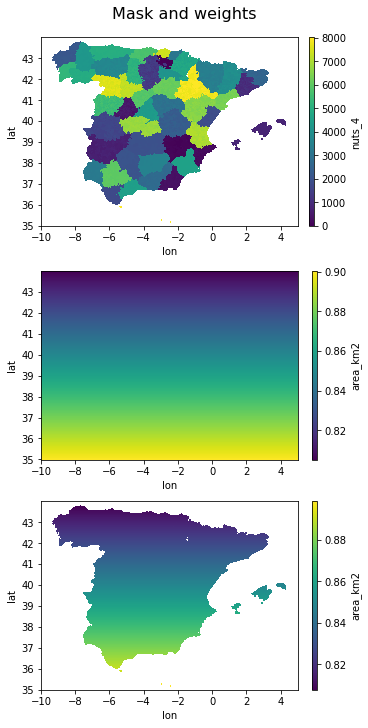


- groupby mask ids...

[########################################] | 100% Completed | 25.4s
[########################################] | 100% Completed | 24.6s
[########################################] | 100% Completed | 26.7s
[########################################] | 100% Completed | 22.5s
[########################################] | 100% Completed | 26.6s
[########################################] | 100% Completed | 24.6s
[########################################] | 100% Completed | 25.9s
[########################################] | 100% Completed | 22.1s

...done


- area-weighted mean CODES:

8017
['ES_01001', 'ES_01002', 'ES_01003', 'ES_01004', 'ES_01006', 'ES_01008', 'ES_01009', 'ES_01010', 'ES_01011', 'ES_01013', 'ES_01014', 'ES_01016', 'ES_01017', 'ES_01018', 'ES_01019', 'ES_01020', 'ES_01021', 'ES_01022', 'ES_01023', 'ES_01027', 'ES_01028', 'ES_01030', 'ES_01031', 'ES_01032', 'ES_01033', 'ES_01034', 'ES_01036', 'ES_01037', 'ES_01039', 'ES_01041', 'ES_01042', 'ES_01043', 'E

In [0]:
%%time
# Process and write to zarr
#import warnings
#warnings.filterwarnings("ignore")
from dask.diagnostics import ProgressBar, Profiler, ResourceProfiler, CacheProfiler
from bokeh.io import output_notebook, show
output_notebook()

for l in [4]:
    p = f"historical-hourly-petmax-quantiles-zs-nuts-level-{l}"
    dsq = zonal_stats_pethq(ds_pethq, l, admin_dict, debug = False)
    dsq['gid'] = dsq['gid'].astype('object')
    print(f"\nWriting level {l} to netcdf...\n")
    delayed_netcdf = dsq.to_netcdf(path=f"{p}.nc", compute=False)
    #delayed_zarr = write_to_remote_zarr(dsq, group=p, root='copernicus-climate/spain-zonal-stats.zarr', show_tree=False, compute=False)
    with Profiler() as prof, ResourceProfiler(dt=1) as rprof, CacheProfiler() as cprof:
        with ProgressBar():
            print("\nWriting to netcdf\n")
            delayed_netcdf.compute()
            #delayed_zarr.compute()
            print("\n Completed\n")
            #show(visualize([prof, rprof, cprof]))


In [0]:
import xarray as xr

tst = xr.open_mfdataset('/content/historical-hourly-petmax-quantiles-zs-nuts-level-4.nc', concat_dim='month')
tst = tst.chunk({'gid':100})
write_to_remote_zarr(tst, group="historical-hourly-petmax-quantiles-zs-nuts-level-4", root='copernicus-climate/spain-zonal-stats.zarr', show_tree=False)

In [0]:
from bokeh.io import output_notebook, show

output_notebook()

tst = rprof.visualize()
#tst.plot_height = 10
#tst.plot_width = 10
show(tst)
#visualize([prof, rprof, cprof])

## Check zarr

CPU times: user 3.76 s, sys: 859 ms, total: 4.62 s
Wall time: 12.7 s


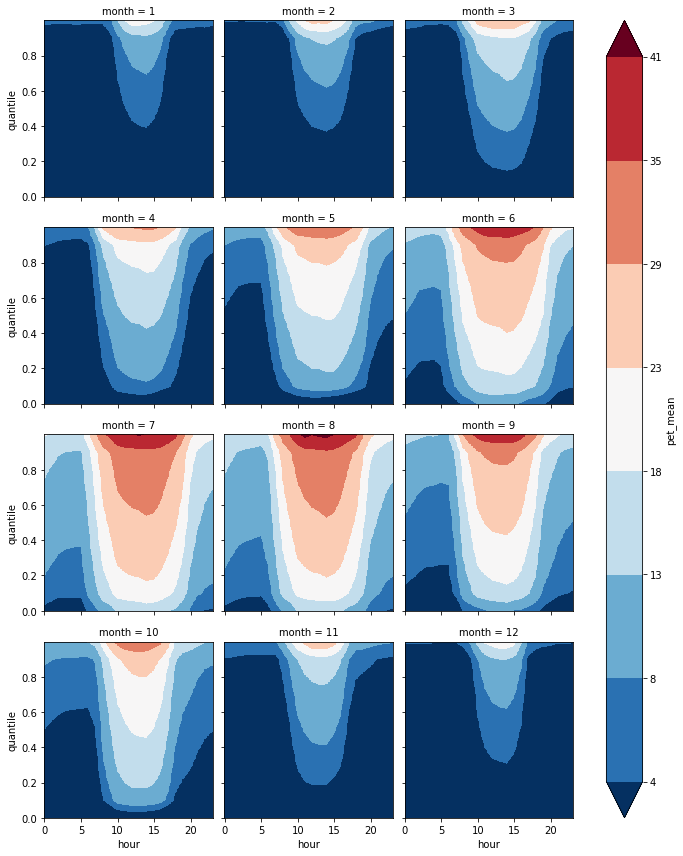

In [0]:
%%time
ds_pethq2 = get_cached_remote_zarr(group=f"historical-hourly-petmax-quantiles-zs-nuts-level-2", root='copernicus-climate/spain-zonal-stats.zarr')
ds_pethq2.pet_mean\
.sel(gid='ES11')\
.interp(quantile = np.arange(0.0, 1.0, 0.0001))\
.interp(hour = np.arange(0.0, 23.0 + 0.1, 0.1))\
.plot(x='hour', y='quantile', col= 'month', col_wrap=3, levels=[4, 8, 13, 18, 23, 29, 35, 41])

CPU times: user 3.66 s, sys: 619 ms, total: 4.28 s
Wall time: 10.7 s


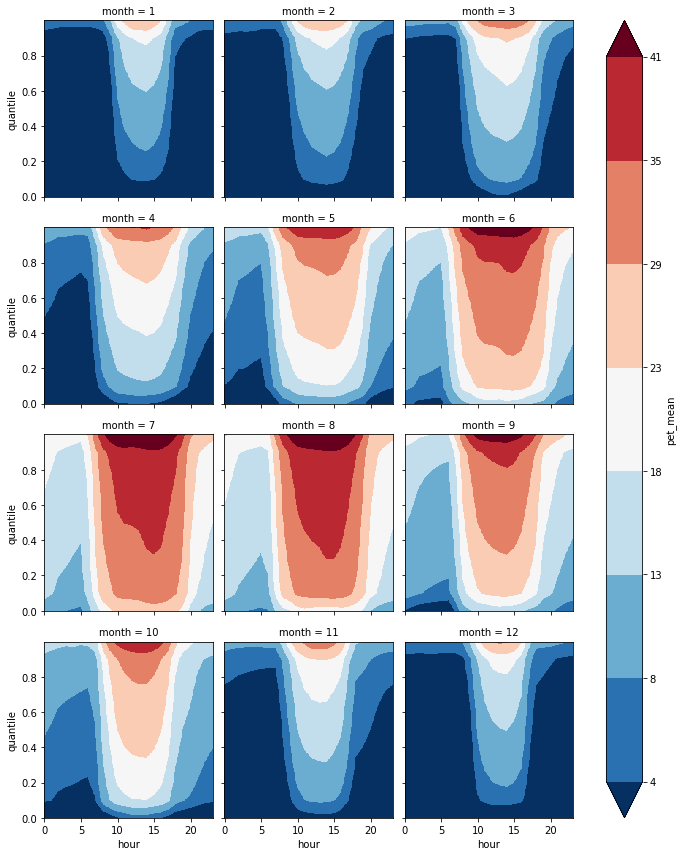

In [0]:
%%time
ds_pethq3 = get_cached_remote_zarr(group=f"historical-hourly-petmax-quantiles-zs-nuts-level-3", root='copernicus-climate/spain-zonal-stats.zarr')
ds_pethq3.pet_mean\
.sel(gid='ES113')\
.interp(quantile = np.arange(0.0, 1.0, 0.0001))\
.interp(hour = np.arange(0.0, 23.0 + 0.1, 0.1))\
.plot(x='hour', y='quantile', col= 'month', col_wrap=3, levels=[4, 8, 13, 18, 23, 29, 35, 41])

CPU times: user 3.48 s, sys: 668 ms, total: 4.15 s
Wall time: 9.69 s


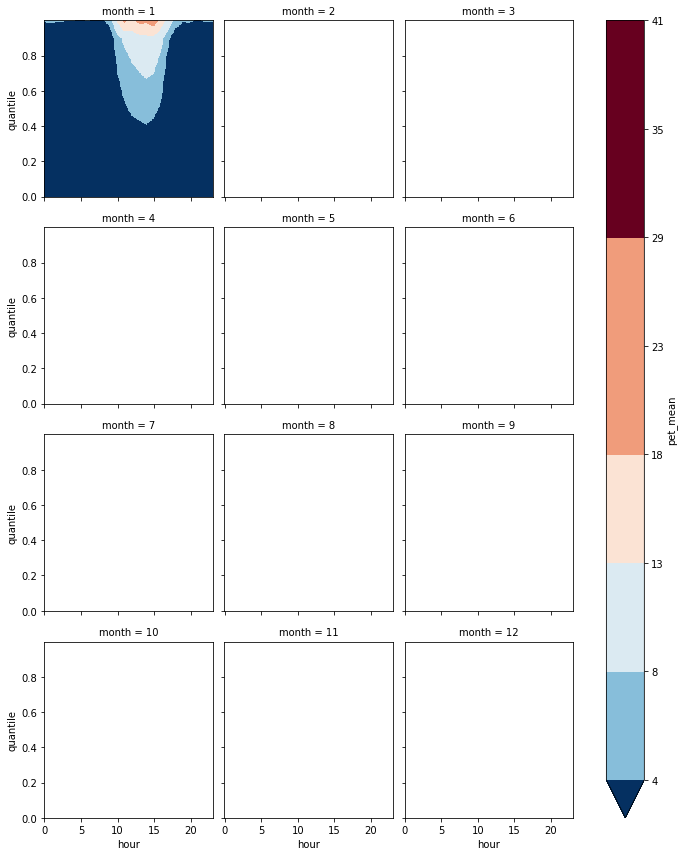

In [0]:
%%time

ds_pethq4 = get_cached_remote_zarr(group="historical-hourly-petmax-quantiles-zs-nuts-level-4", root='copernicus-climate/spain-zonal-stats.zarr')
ds_pethq4.pet_mean\
.sel(gid='ES_50259')\
.interp(quantile = np.arange(0.0, 1.0, 0.0001))\
.interp(hour = np.arange(0.0, 23.0 + 0.1, 0.1))\
.plot(x='hour', y='quantile', col= 'month', col_wrap=3, levels=[4, 8, 13, 18, 23, 29, 35, 41])

In [0]:
%%time
write_to_remote_zarr(out, 'historical-pet-histogram', 'copernicus-climate/spain.zarr')